In [11]:
%matplotlib inline

from __future__ import print_function

import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
# manualSeed = random.randint(1, 10000)  # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [12]:
# Root directory for dataset
dataroot = "img_align_celeba"
# Number of workers for dataloader
workers = 2
# Batch size during training
batch_size = 256
# Spatial size of training images. All images will be resized to this size using a transformer.
image_size = 64
# Number of channels in the training images. For color images this is 3
nc = 3
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Learning rate for optimizers
lr = 0.0005
# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

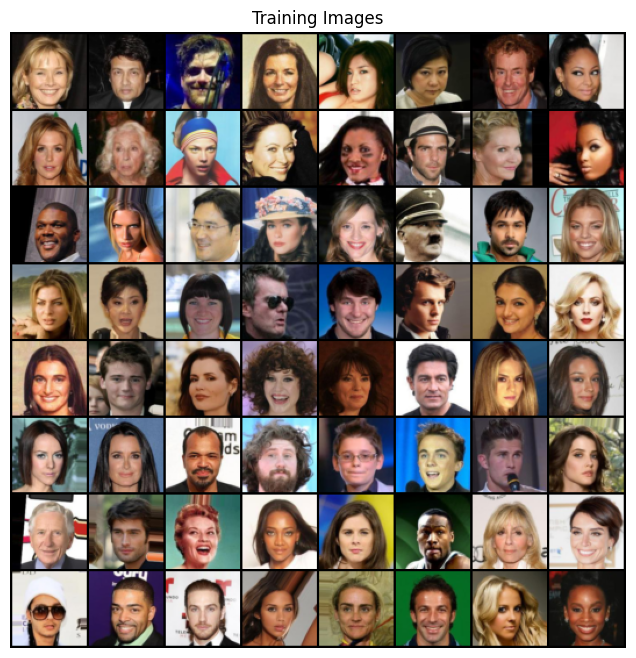

In [13]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[192:], padding=2, normalize=True).cpu(),(1,2,0)))

In [14]:
# custom weights initialization called on netG and netD
def weights_init(m):
  classname = m.__class__.__name__
  if classname.find('Conv') != -1:
    nn.init.normal_(m.weight.data, 0.0, 0.02)
  elif classname.find('BatchNorm') != -1:
    nn.init.normal_(m.weight.data, 1.0, 0.02)
    nn.init.constant_(m.bias.data, 0)

In [15]:
class Generator(nn.Module):
  def __init__(self, nz, ngf, nc):
    super(Generator, self).__init__()
    # TODO: finish implementing the network architecture
    self.seq = nn.Sequential(
      # TODO: the first ConvTranspose2d layer will take the noise as input with size of 100
      # so you will need at least one ConvTranspose2d layer, one BatchNorm2d layer followed by a ReLU activation here

      # ENDS HERE
      nn.ConvTranspose2d(nz, ngf * 8, kernel_size=4, stride=1, padding=0, bias=False),
      nn.BatchNorm2d(ngf * 8),
      nn.ReLU(),
      nn.ConvTranspose2d(ngf * 8, ngf * 4, kernel_size=4, stride=2, padding=1, bias=False),
      nn.BatchNorm2d(ngf * 4),
      nn.ReLU(),

      nn.ConvTranspose2d(ngf * 4, ngf * 2, kernel_size=4, stride=2, padding=1, bias=False),
      nn.BatchNorm2d(ngf * 2),
      nn.ReLU(),
      nn.ConvTranspose2d(ngf * 2, ngf, kernel_size=4, stride=2, padding=1, bias=False),
      nn.BatchNorm2d(ngf),
      nn.ReLU(),

      nn.ConvTranspose2d(ngf, nc, kernel_size=4, stride=2, padding=1, bias=False),
      nn.Tanh() 
    )

  def forward(self, input):
    x = self.seq(input)
    return x

In [16]:
nz = 100  # random noise dim
ngf = 64  # generator feature dim
ndf = 64  # discrimeter feature dim
nc = 3

In [17]:
# Create the generator
netG = Generator(nz, ngf, nc).to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (seq): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [18]:
class Discriminator(nn.Module):
  def __init__(self, nc, ndf):
    super(Discriminator, self).__init__()
    # TODO: finish implementing the network architecture
    self.seq = nn.Sequential(
            nn.Conv2d(nc, ndf, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf, ndf * 2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 2, ndf * 4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 4, ndf * 8, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 8, 1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid() 
    )

  def forward(self, input):
    x = self.seq(input)
    return x

In [19]:
# Create the Discriminator
netD = Discriminator(nc, ndf).to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (seq): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [20]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [21]:
# Training Loop
num_epochs = 30

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ######################################################
        # 1. Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ######################################################

        # Initialize the gradient of D
        netD.zero_grad()

        # 1.1 Calculate the loss with all-real batch

        # Format batch
        real_batch = data[0].to(device)
        b_size = real_batch.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_batch).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        # 1.2 Calculate the loss with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G and a label array
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        # Calculate the mean of output, D_G_z1, from netD with your fake batch
        D_G_z1 = output.mean().item()

        # 1.3 Combine the loss from all-real batch and all-fake batch
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D with step()
        optimizerD.step()

        ######################################################
        # 2. Update G network: maximize log(D(G(z)))
        ######################################################

        # TODO: Initialize the gradient of G
        netG.zero_grad()
        # TODO: create the label array, remember fake labels are real for generator cost
        label.fill_(real_label)
        # TODO: Since we just updated D, perform another forward pass of all-fake batch throu$gh D as output (you are not suppose to detach here!)
        output = netD(fake).view(-1)
        # TODO: Calculate G's loss based on this output
        errG = criterion(output, label)
        # TODO: Calculate gradients using backword() for G's loss
        errG.backward()
        # TODO: Calculate the mean of output, D_G_z2, from netD with your fake batch
        D_G_z2 = output.mean().item()
        # TODO: Update G with step
        optimizerG.step()
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/30][0/792]	Loss_D: 1.6763	Loss_G: 17.1495	D(x): 0.7447	D(G(z)): 0.6683 / 0.0000
[0/30][50/792]	Loss_D: 0.2426	Loss_G: 7.3641	D(x): 0.8865	D(G(z)): 0.0128 / 0.0070
[0/30][100/792]	Loss_D: 2.2172	Loss_G: 2.6791	D(x): 0.3075	D(G(z)): 0.0893 / 0.1293
[0/30][150/792]	Loss_D: 1.9641	Loss_G: 1.4994	D(x): 0.2471	D(G(z)): 0.0921 / 0.2596
[0/30][200/792]	Loss_D: 0.8612	Loss_G: 2.4003	D(x): 0.6503	D(G(z)): 0.2920 / 0.1115
[0/30][250/792]	Loss_D: 2.2985	Loss_G: 1.8700	D(x): 0.1913	D(G(z)): 0.0506 / 0.2344
[0/30][300/792]	Loss_D: 1.2912	Loss_G: 1.4159	D(x): 0.4508	D(G(z)): 0.2195 / 0.2984
[0/30][350/792]	Loss_D: 1.1322	Loss_G: 2.2304	D(x): 0.4978	D(G(z)): 0.1884 / 0.1471
[0/30][400/792]	Loss_D: 1.1805	Loss_G: 2.5981	D(x): 0.5225	D(G(z)): 0.2316 / 0.1074
[0/30][450/792]	Loss_D: 1.4020	Loss_G: 2.5135	D(x): 0.5629	D(G(z)): 0.4665 / 0.1205
[0/30][500/792]	Loss_D: 1.1119	Loss_G: 2.8545	D(x): 0.6339	D(G(z)): 0.3958 / 0.0781
[0/30][550/792]	Loss_D: 1.1477	Loss_G: 3.2187	D(x): 

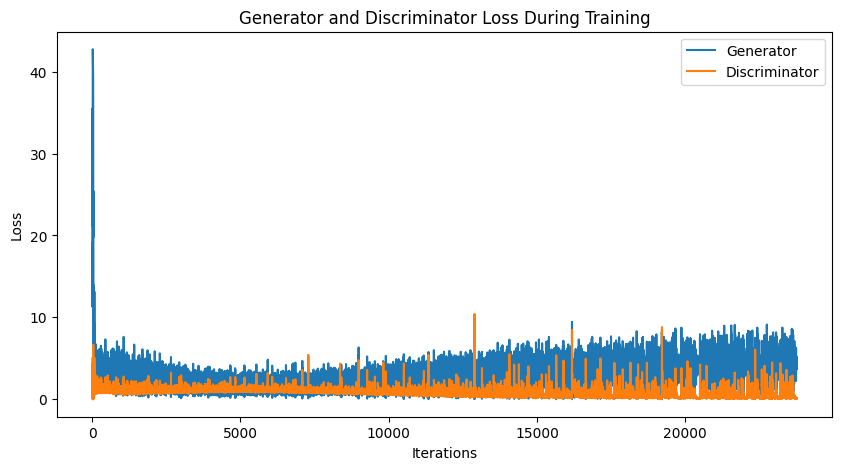

In [25]:
# plot Generator and Discriminator Loss During Training
import matplotlib.pyplot as plt

# Plot Generator and Discriminator Loss During Training
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="Generator")
plt.plot(D_losses, label="Discriminator")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


Animation size has reached 20992552 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


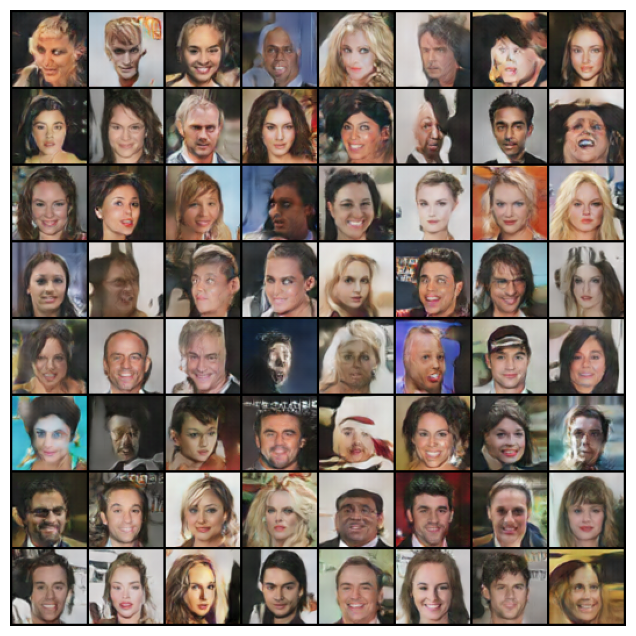

In [23]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

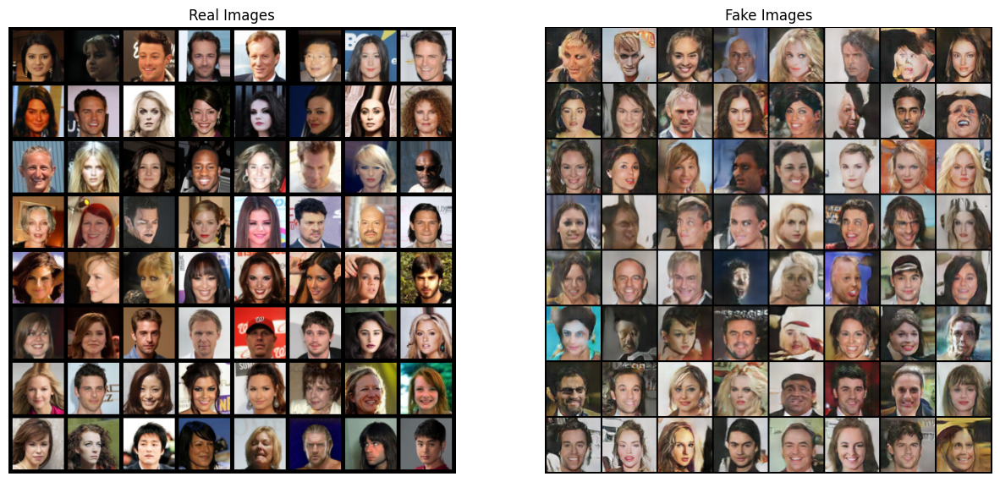

In [26]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15, 15))
plt.subplot(1, 2, 1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(), (1, 2, 0)))

# Plot the fake images from the last epoch
plt.subplot(1, 2, 2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1], (1, 2, 0)))

plt.show()